In [2]:
%reload_ext autoreload
%autoreload 2
%matplotlib inline

In [3]:
import warnings
warnings.filterwarnings("ignore")

In [4]:
import sqlite3
import numpy as np
from SlideRunner.dataAccess.database import Database
from tqdm import tqdm
from pathlib import Path
import openslide
import time
import pickle
import cv2

In [5]:
from fastai import *
from fastai.vision import *
from fastai.callbacks import *
from fastai.data_block import *

In [6]:
import matplotlib.pyplot as plt

In [7]:
from helper.nms_grid import non_max_suppression_by_grid
from helper.nms import non_max_suppression_fast
from helper.nms_prob import non_max_suppression
from helper.nms_center_distance import non_max_suppression_by_distance

In [43]:
from BoundingBox import BoundingBox
from BoundingBoxes import BoundingBoxes
from Evaluator import *
from utils import *

In [8]:
path = Path('/data/Datasets/EIPH_WSI/')

In [44]:
database = Database()
database.open(str(path/'EIPH.sqlite'))

True

In [45]:
files = []
lbl_bbox = []

getslides = """SELECT uid, filename FROM Slides"""
for currslide, filename in tqdm(database.execute(getslides).fetchall()):
    database.loadIntoMemory(currslide)

    check = True if 'erliner' in filename else False
    slidetype = 'Berliner Blau/' if check else 'Turnbull Blue/'

    slide_path = path / slidetype / filename

    down_factor = 1

    classes = {3: 0, 4: 1, 5: 2, 6: 3, 7: 4}#{3: 1, 4: 2, 5: 3, 6: 4, 7: 5} #
    labels, bboxes = [], []
    for id, annotation in database.annotations.items():
        if annotation.labels[0].classId in classes:
            d = 2 * annotation.r / down_factor
            x_min = (annotation.x1 - annotation.r) / down_factor
            y_min = (annotation.y1 - annotation.r) / down_factor
            x_max = x_min + d
            y_max = y_min + d
            label = classes[annotation.labels[0].classId]

            bboxes.append([int(x_min), int(y_min), int(x_max), int(y_max)])
            labels.append(label)

    if len(bboxes) > 0:
        lbl_bbox.append([bboxes, labels])
        files.append(slide_path)

img2bbox = dict(zip(files, np.array(lbl_bbox)))
get_y_func = lambda o:img2bbox[o]

  0%|          | 0/24 [00:00<?, ?it/s]

Loading DB into memory ...


  4%|▍         | 1/24 [00:00<00:06,  3.44it/s]

Loading DB into memory ...


  8%|▊         | 2/24 [00:01<00:13,  1.59it/s]

Loading DB into memory ...


 12%|█▎        | 3/24 [00:02<00:12,  1.65it/s]

Loading DB into memory ...


 21%|██        | 5/24 [00:02<00:08,  2.37it/s]

Loading DB into memory ...
Loading DB into memory ...
Loading DB into memory ...


 33%|███▎      | 8/24 [00:03<00:05,  3.15it/s]

Loading DB into memory ...
Loading DB into memory ...


 46%|████▌     | 11/24 [00:03<00:02,  4.83it/s]

Loading DB into memory ...
Loading DB into memory ...
Loading DB into memory ...


 50%|█████     | 12/24 [00:04<00:02,  4.05it/s]

Loading DB into memory ...
Loading DB into memory ...
Loading DB into memory ...
Loading DB into memory ...


 71%|███████   | 17/24 [00:04<00:01,  4.65it/s]

Loading DB into memory ...
Loading DB into memory ...


 79%|███████▉  | 19/24 [00:05<00:00,  5.75it/s]

Loading DB into memory ...
Loading DB into memory ...
Loading DB into memory ...


 88%|████████▊ | 21/24 [00:05<00:00,  4.54it/s]

Loading DB into memory ...
Loading DB into memory ...


100%|██████████| 24/24 [00:06<00:00,  3.52it/s]

Loading DB into memory ...


In [71]:
def calc_ap(annotations, boxes_gt, labels_gt, file:str="temp.png"):
    boundingBoxes = BoundingBoxes()
    evaluator = Evaluator()

    boxes_pred = annotations[:, [0, 1, 2, 3]]
    # change pred from x,y,x2,y2 -> x,y,w,h
    boxes_pred[:, 2:] = boxes_pred[:, 2:] - boxes_pred[:, :2]
    labels_pred = annotations[:, 4]
    score_pred = annotations[:, 5]


    for box, cla in zip(boxes_gt, labels_gt):
        temp = BoundingBox(imageName=str(file), classId=cla, x=box[0],
                                       y=box[1],
                                       w=box[2], h=box[3], typeCoordinates=CoordinatesType.Absolute,
                                       bbType=BBType.GroundTruth, format=BBFormat.XYWH, imgSize=(5000, 5000))
        boundingBoxes.addBoundingBox(temp)

    for box, cla, scor in zip(boxes_pred, labels_pred, score_pred):
        temp = BoundingBox(imageName=str(file), classId=cla, x=box[0],
                                       y=box[1], classConfidence=scor,
                                       w=box[2], h=box[3], typeCoordinates=CoordinatesType.Absolute,
                                       bbType=BBType.Detected, format=BBFormat.XYWH, imgSize=(5000, 5000))
        boundingBoxes.addBoundingBox(temp)

    metricsPerClass = evaluator.GetPascalVOCMetrics(boundingBoxes, iou_threshold)
    return np.mean([mc['AP'] for mc in metricsPerClass])


In [47]:
resultsArchive = pickle.load(open('inference_results_boxes.p','rb'))

In [48]:
keys = list(resultsArchive.keys())

In [49]:
filename = keys[0]
filename

'01_EIPH_563479 Berliner Blau.svs'

In [55]:
files[0].parent

PosixPath('/data/Datasets/EIPH_WSI/Berliner Blau')

In [67]:
boxes_gt, labels_gt = get_y_func(files[0].parent/filename)
boxes_gt, labels_gt = np.array(boxes_gt), np.array(labels_gt)
boxes_gt[:, 2:] = boxes_gt[:, 2:] - boxes_gt[:, :2]

In [12]:
annotations = np.array(resultsArchive[filename])

In [58]:
iou_threshold = 0.25

### NMS no prob

In [38]:
%%time
annotations_nms = non_max_suppression_fast(annotations, iou_threshold)

print("Elements: {}".format(len(annotations_nms)))

Elements: 5503
CPU times: user 3.13 s, sys: 76 µs, total: 3.13 s
Wall time: 3.13 s


In [72]:
calc_ap(annotations_nms, boxes_gt, labels_gt)

0.468703354314417

### NMS by Grid

In [14]:
%%time
annotations_nms_grid = non_max_suppression_by_grid(annotations)

print("Elements: {}".format(len(annotations_nms_grid)))

Elements: 7732
CPU times: user 835 ms, sys: 2.26 ms, total: 837 ms
Wall time: 837 ms


In [74]:
calc_ap(annotations_nms_grid, boxes_gt, labels_gt)

0.6201422467508092

### NMS by IOU and score

In [39]:
%%time
annotations_nms_prob = non_max_suppression(annotations, annotations[:, 5], iou_threshold)
annotations_nms_prob = annotations[annotations_nms_prob]
print("Elements: {}".format(len(annotations_nms_prob)))

Elements: 7797
CPU times: user 25.1 s, sys: 0 ns, total: 25.1 s
Wall time: 25.1 s


In [75]:
calc_ap(annotations_nms_prob, boxes_gt, labels_gt)

0.6463322199122223

### NMS by distance

In [79]:
%%time
annotations_nms_dist = non_max_suppression_by_distance(annotations, annotations[:, 5], radius=50)
print("Elements: {}".format(len(annotations_nms_dist)))

Elements: 6664
CPU times: user 850 ms, sys: 0 ns, total: 850 ms
Wall time: 847 ms


In [80]:
calc_ap(annotations_nms_dist, boxes_gt, labels_gt)

0.6458146650357519

In [18]:
check = True if 'erliner' in filename else False
slidetype = 'Berliner Blau/' if check else 'Turnbull Blue/'

slide = openslide.open_slide(str(path/slidetype/filename))

In [19]:
def get_ImageBBox(bboxes, labels,x,y,h,w):
    bboxes = np.array(bboxes)
    labels = np.array(labels)

    bboxes[:, [0, 2]] = bboxes[:, [0, 2]] - x
    bboxes[:, [1, 3]] = bboxes[:, [1, 3]] - y

    bb_widths = (bboxes[:, 2] - bboxes[:, 0]) / 2
    bb_heights = (bboxes[:, 3] - bboxes[:, 1]) / 2

    ids = ((bboxes[:, 0] + bb_widths) > 0) & ((bboxes[:, 1] + bb_heights) > 0) & ((bboxes[:, 2] - bb_widths) < w) & ((bboxes[:, 3] - bb_heights) < h)

    bboxes = bboxes[ids]
    bboxes = np.clip(bboxes, 0, x)
    bboxes = bboxes[:, [1, 0, 3, 2]]

    labels = labels[ids]
    return bboxes,  labels

In [20]:
def draw_rects(bboxes, labels, image):
    
    colors = {0: (0,255,0), 1: (128,255,0), 2: (128,128,0), 3: (255,0,0), 4: (0,0,255)}
    
    for box, label in zip(bboxes, labels):
        cv2.rectangle(image, (int(box[1]), int(box[0])), (int(box[3]), int(box[2])),  colors[label], 3)
    return image

In [87]:
def draw_rects(bboxes, labels, axis):
    for box, label in zip(bboxes, labels):
        colors = ['b', 'g', 'r', 'c', 'm']

        patch = ax1.add_patch(
            patches.Rectangle((box[1], box[0]), width=box[3] - box[1], height=box[2] - box[0], fill=False,
                              edgecolor=colors[label], lw=2))

In [88]:
def create_results(axis, annotations_temp, x, y, height, width, threshold = 0.3):
    ids = annotations_temp[:, 5] > threshold
    
    bboxes = annotations_temp[ids][:, :4]
    labels = annotations_temp[ids][:, 4].astype(int)
    bboxes, labels = get_ImageBBox(bboxes, labels, x, y, height, width)
    
    return draw_rects(bboxes, labels, axis)

In [22]:
x = 10000
y = 10000
width = 2048
height = 2048
threshold = 0.5

In [23]:
image_np = np.array(slide.read_region(location=(x,y),
                                          level=0, size=(width, height)))[:, :, :3]

In [40]:
image_nms = create_results(image_np, annotations_nms, x, y, height, width, threshold)
image_grid = create_results(image_np, annotations_nms_grid, x, y, height, width, threshold)
image_nms_prob = create_results(image_np, annotations_nms_prob, x, y, height, width, threshold)
image_nms_dist = create_results(image_np, annotations_nms_dist, x, y, height, width, threshold)

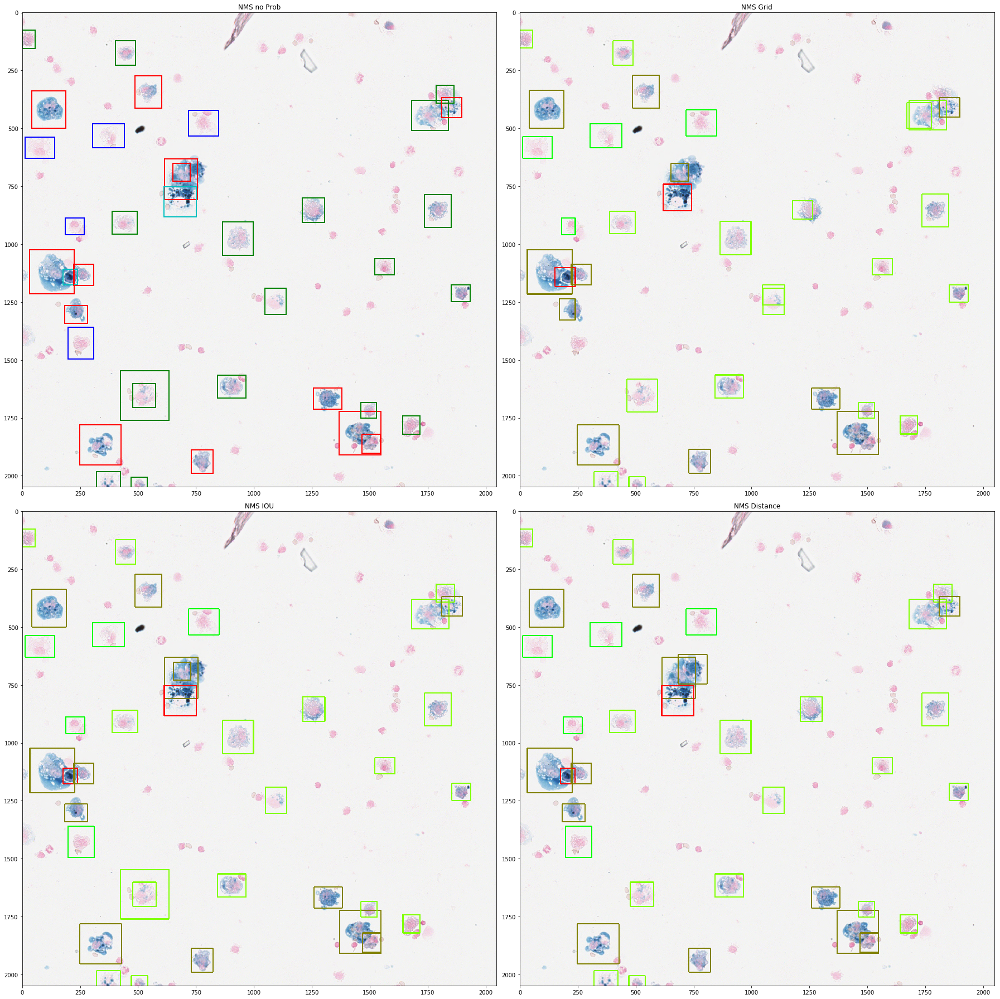

In [90]:
_, ((ax1, ax2), (ax3, ax4)) = plt.subplots(nrows=2, ncols=2, figsize=(25,25)) #, figsize=(5,5)
create_results(ax1, annotations_nms_prob, x, y, height, width, threshold)
ax1.set_title("NMS no Prob")
ax1.imshow(image_np)

ax2.set_title("NMS Grid")
create_results(ax2, annotations_nms_grid, x, y, height, width, threshold)
ax2.imshow(image_np)

ax3.set_title("NMS IOU")
create_results(ax3, annotations_nms_prob, x, y, height, width, threshold)
ax3.imshow(image_np)

ax4.set_title("NMS Distance")
create_results(ax4, annotations_nms_dist, x, y, height, width, threshold)
ax4.imshow(image_np)

plt.tight_layout()

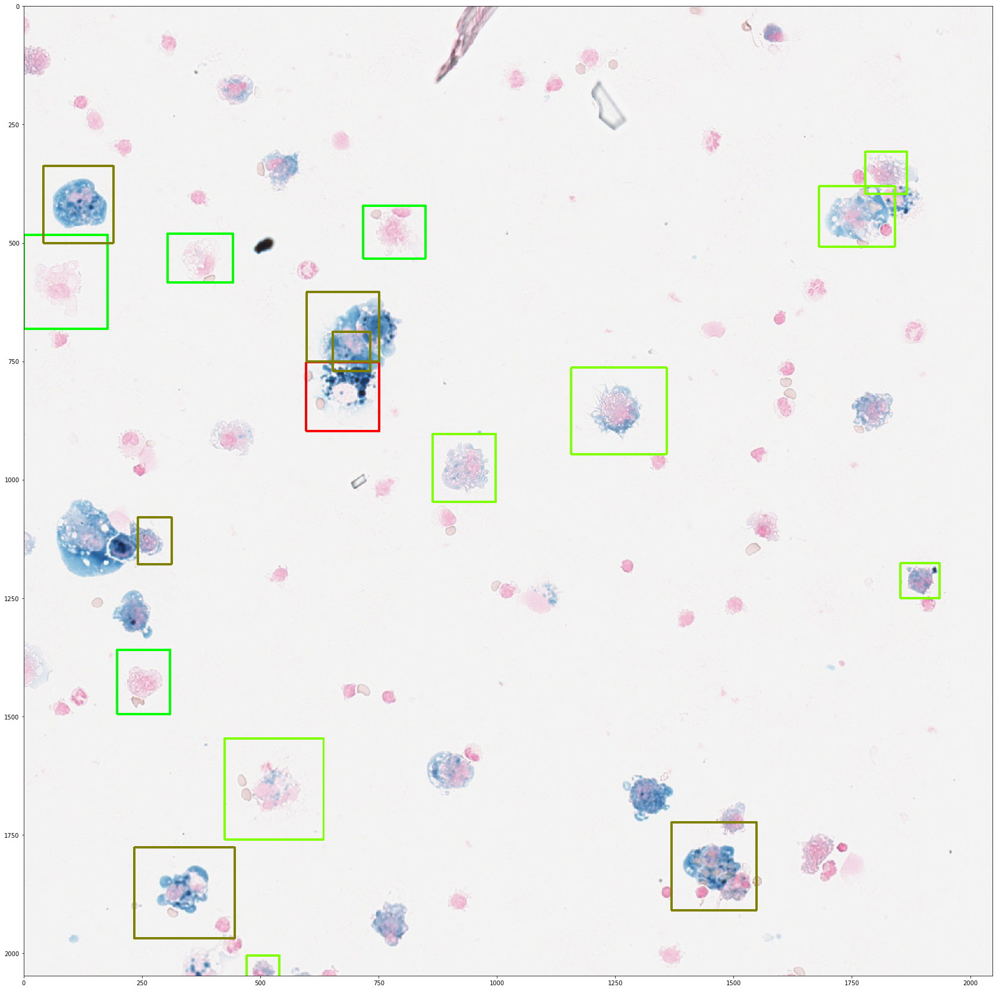

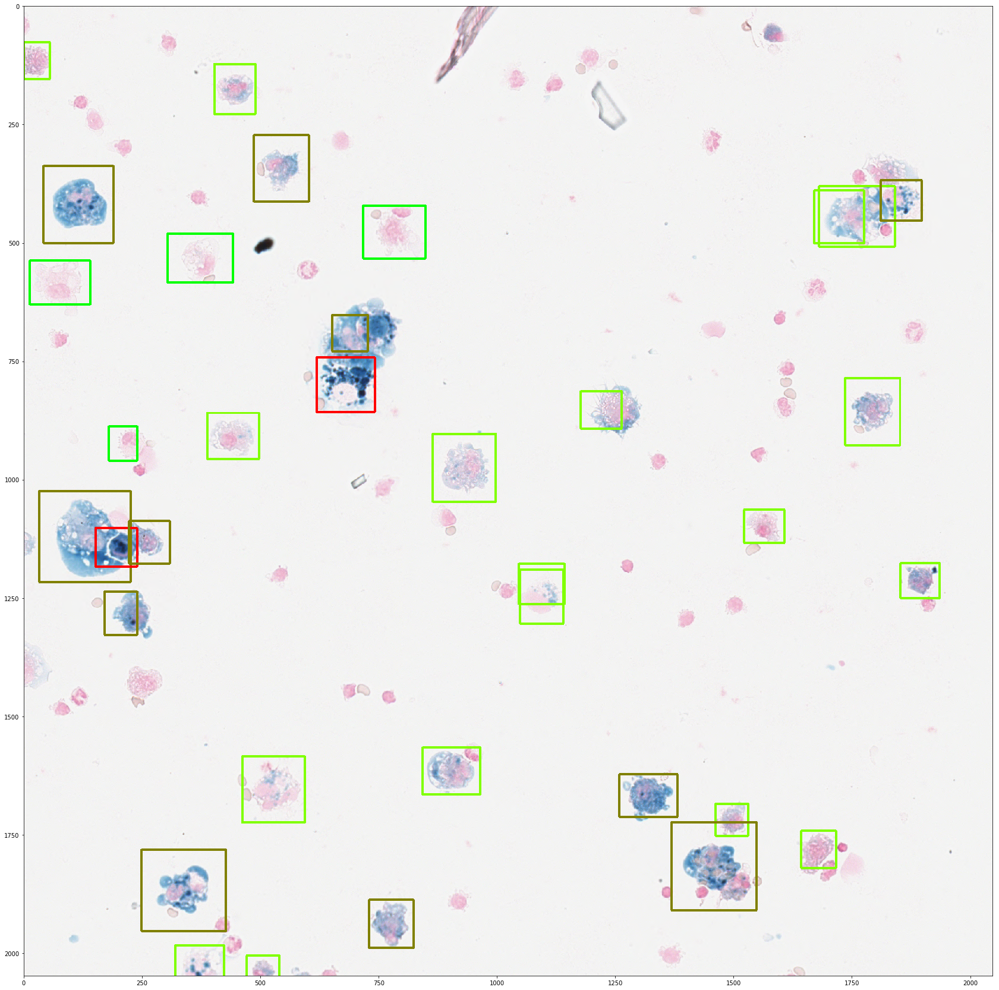

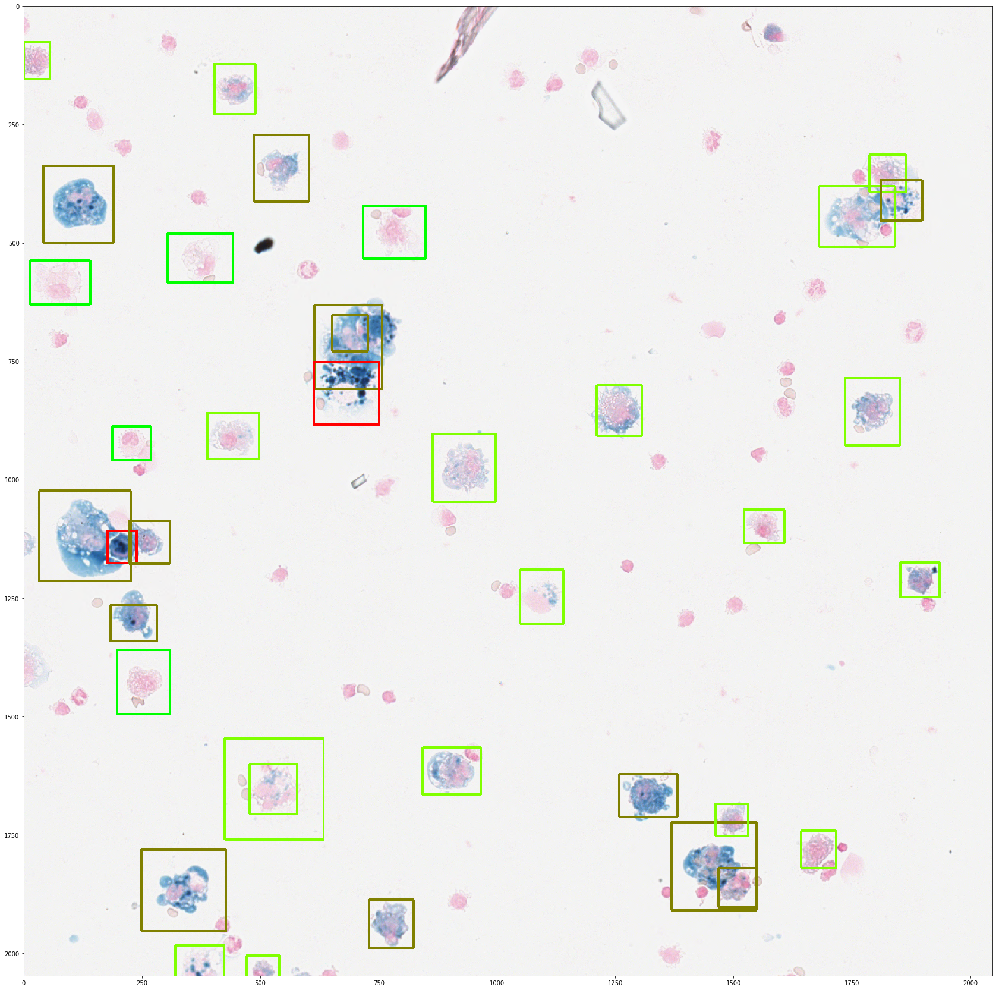

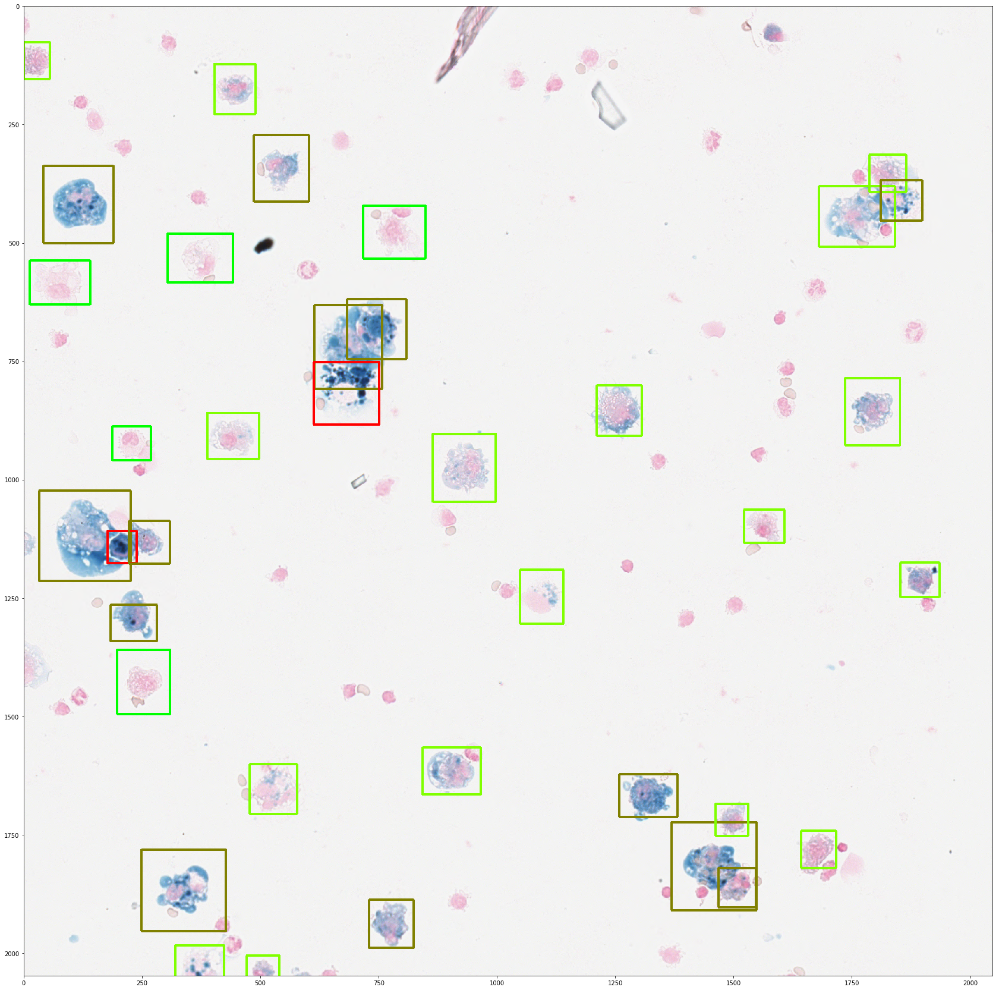

In [42]:
for image in [image_nms, image_grid, image_nms_prob, image_nms_dist]:
    fig = plt.figure(figsize = (30, 30)) 
    ax = fig.add_subplot(111)
    ax.imshow(image)